## MODS 207: Dynamic Factors Model in Finance
### Ristorcelli Ulysse and Vujasinovic Thomas

In [30]:
# Imports :
import pandas as pd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
import yfinance as yf
import plotly.graph_objects as go
import plotly.io as pio
import datetime as dt
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.seasonal import seasonal_decompose
pio.templates.default = "plotly_white"
from plotly.subplots import make_subplots

## Data recovery and some plots:

In [31]:
# Imports de capitalisations boursières des grandes entreprises du tourisme
def get_data(assets, start_date, end_date):
    """
    Récupère les données des actions sur Yahoo Finance
    """
    return yf.download(assets, start=start_date, end=end_date)['Adj Close']

defense_assets = ['MLHK.PA','BA.L','SAF.PA','DAA2.VI','LMT', 'NOC', 'RTX', 'GD', 'BA', 'BAES.L', 'AIR.PA', 'LDO.MI', 'HO.PA', 'HII', 'LHX', 'HON', 'SAAB-B.ST','RHM.DE']
basic_materials =['GOLD','BZ=F','SI=F','HG=F','NG=F','KC=F','ZC=F','ZO=F','KE=F','ZR=F','ZS=F','HE=F','LE=F','CC=F','CT=F','LBS=F','OJ=F']
automobile_assets=['TSLA','GM','F','RIVN','LOT','7201.T','RNO.PA','FR.PA','ML.PA','TM','HMC','NSANY','VWAGY','DDAIF','BMWYY','RACE','BWA','APTV','MGA','LEA','DLPH','VC','CTTAY','CLR','CMI','WBC','ALV','THRM','APTV','VLEEY','DAN','BWA','JCI','ADNT','CMI','WBC','XOM','RDS.A','CVX','BP','2222.SR','BRDCY','GT','CTTAY']
N = 5000 # Complétez avec le nombre de jours historiques

start_date = dt.datetime.now() - dt.timedelta(days=N)
end_date = dt.datetime.now()

basic_materials_data=get_data(basic_materials, start_date,end_date)
defense_data = get_data(defense_assets, start_date, end_date)
automobile_data= get_data(automobile_assets,start_date,end_date)
#defense_data = defense_data.drop(defense_data.index[-1])
defense_data


[*********************100%%**********************]  17 of 17 completed
[*********************100%%**********************]  18 of 18 completed
[*********************100%%**********************]  39 of 39 completed


5 Failed downloads:
['DLPH', 'CLR', 'RDS.A', 'DDAIF', 'WBC']: Exception('%ticker%: No timezone found, symbol may be delisted')


,AIR.PA,BA,BA.L,BAES.L,DAA2.VI,GD,HII,HO.PA,HON,LDO.MI,LHX,LMT,MLHK.PA,NOC,RHM.DE,RTX,SAAB-B.ST,SAF.PA
Date,,,,,,,,,,,,,,,,,,
2010-09-27,16.044243,50.722610,189.563858,NaN,NaN,45.657822,NaN,20.196163,31.110188,7.470945,33.001408,47.370403,NaN,41.192368,35.672493,32.080276,8.175776,17.278456
2010-09-28,15.860974,51.222771,185.131226,NaN,NaN,45.759094,NaN,20.095409,31.358559,7.567233,33.446068,47.429302,NaN,41.363228,35.427242,32.392429,8.424282,17.141710
2010-09-29,15.615232,52.373932,186.882401,NaN,NaN,45.607220,NaN,20.102873,31.252123,7.580362,33.186680,47.049706,NaN,41.144527,35.588303,32.342678,8.204770,16.940611
2010-09-30,15.240367,52.826466,187.320175,NaN,NaN,45.426411,NaN,20.009577,31.181147,7.628506,32.823540,46.650467,NaN,41.438412,35.507774,32.225037,8.092942,16.586674
2010-10-01,15.061261,53.056686,187.758041,NaN,NaN,45.173267,NaN,19.785675,31.330172,7.589116,33.127380,45.557514,NaN,41.233379,35.910446,32.179802,7.869290,16.260897
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-28,158.460007,175.080002,1371.500000,4.79025,202.600006,297.339996,251.442078,164.000000,199.179993,23.530001,218.869995,458.480011,116.0,455.500000,523.599976,105.519997,247.500000,214.800003
2024-05-29,156.740005,171.649994,1362.000000,4.85000,199.199997,293.480011,247.015106,164.050003,197.070007,23.059999,215.240005,452.720001,116.0,446.390015,515.000000,104.570000,235.600006,212.600006
2024-05-30,159.100006,172.750000,1373.000000,4.85400,194.899994,296.079987,249.919998,164.300003,200.910004,23.090000,219.169998,460.940002,116.0,446.519989,516.599976,105.720001,240.000000,213.800003


In [32]:
# Création d'un quadrillage de subplots 2x2
fig = make_subplots(rows=2, cols=2, subplot_titles=(
    'Evolution des prix des actifs défense',
    'Evolution des prix des actifs matériaux bruts',
    'Evolution des prix des actifs automobile',
   ))

# Ajout des traces pour les actifs de défense
for a in defense_assets:
    fig.add_trace(go.Scatter(x=defense_data.index, y=defense_data[a], name=a),
                  row=1, col=1)

# Ajout des traces pour les actifs matériaux bruts
for a in basic_materials:
    fig.add_trace(go.Scatter(x=basic_materials_data.index, y=basic_materials_data[a], name=a),
                  row=1, col=2)

# Ajout des traces pour les actifs automobile
for a in automobile_assets:
    fig.add_trace(go.Scatter(x=automobile_data.index, y=automobile_data[a], name=a),
                  row=2, col=1)



# Mise à jour de la mise en page
fig.update_layout(title_text='Evolution des prix des actifs par catégorie', showlegend=False)

# Affichage du graphique
fig.show()


In [33]:
fig = go.Figure()
for a in defense_assets:
    fig.add_trace(go.Scatter(x=defense_data.index, y=defense_data[a], name=a))
fig.update_layout(title='Evolution des prix des actifs défense', yaxis_title='Prix en $')
fig.show()

In [34]:
defense_data.index = pd.to_datetime(defense_data.index)
automobile_data.index = pd.to_datetime(automobile_data.index)
basic_materials_data.index = pd.to_datetime(basic_materials_data.index)

defense_returns = defense_data.resample('M').mean()
automobile_returns =automobile_data.resample('M').mean()
basic_materials_return=basic_materials_data.resample('M').mean()


# Calcul des rendements logarithmiques quotidiens pour chaque colonne
defense_returns = np.log(defense_data / defense_data.shift(1))

# Renommer les colonnes pour indiquer qu'il s'agit de rendements logarithmiques
defense_returns.columns = [col + '_log_return' for col in defense_data.columns]

automobile_returns = np.log(automobile_data / automobile_data.shift(1))
automobile_returns.columns = [col + '_log_return' for col in automobile_data.columns]

basic_materials_return = np.log(basic_materials_data / basic_materials_data.shift(1))
basic_materials_return.columns = [col + '_log_return' for col in basic_materials_data.columns]


## Factors series:
In the case of the defense industry:

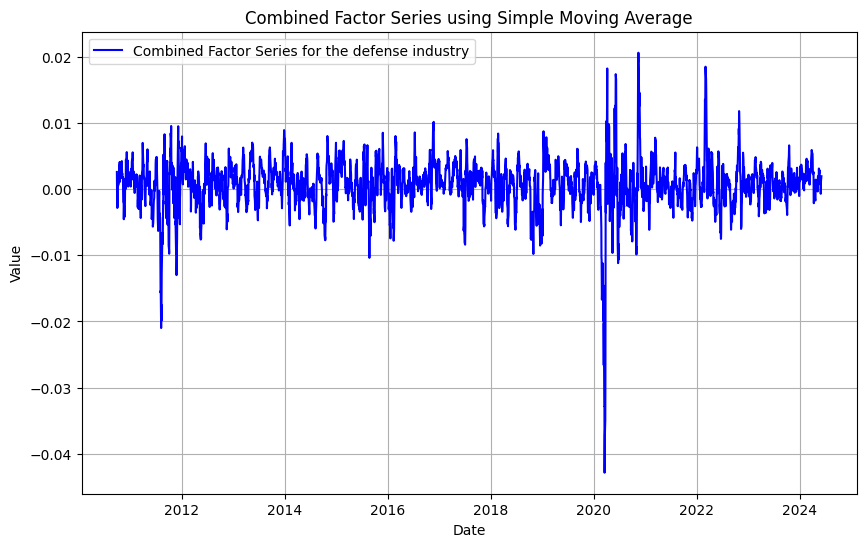

In [35]:
# Factor series using simple moving average
def calculate_sma(series, window=10):
    return series.rolling(window=window, min_periods=1).mean()  

facser = defense_returns.apply(calculate_sma)
comb_facser = facser.mean(axis=1)  

tick_frequency = 24
plt.figure(figsize=(10, 6))
plt.plot(comb_facser.index, comb_facser.values, label='Combined Factor Series for the defense industry', color='blue')
plt.title('Combined Factor Series using Simple Moving Average')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.grid(True)

plt.show()

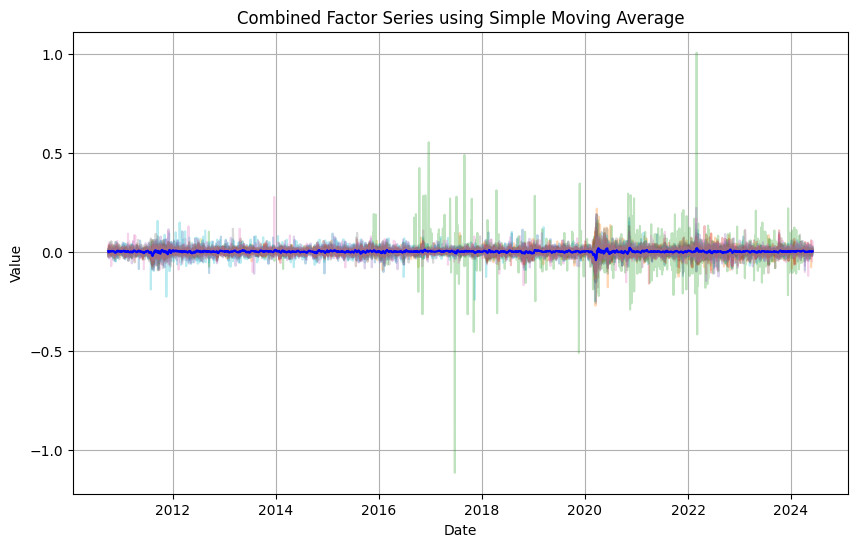

In [36]:
# Comparison of factor series with individual factors
plt.figure(figsize=(10, 6))
for column in defense_returns.columns:
    plt.plot(defense_returns.index, defense_returns[column].values, label=column, alpha=0.3)  
plt.plot(comb_facser.index, comb_facser.values, label='Combined Factor Series', color='blue')
plt.title('Combined Factor Series using Simple Moving Average')
plt.xlabel('Date')
plt.ylabel('Value')
plt.grid(True)
plt.show()

## Dynamic factors model: 

In [37]:
# DFM using state space modeling
# Assuming a simple random walk model for the state equation: factor[t] = factor[t-1] + noise
def state_equation(factor, noise):
    return factor.shift(1) + noise

def observation_equation(factors, loadings):
    return factors.dot(loadings.T)

mod = sm.tsa.DynamicFactor(endog=defense_returns, k_factors=1, factor_order=30)

res = mod.fit(method='powell', disp=False)

print(res.summary())


C:\Users\vujas\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



In [ ]:
import statsmodels.api as sm
import pandas as pd

# Assuming defense_returns is your DataFrame with log returns

def calculate_model_metrics(endog, max_factors, max_order):
    results = []
    for k_factors in range(1, max_factors + 1):
        for factor_order in range(1, max_order + 1):
            try:
                mod = sm.tsa.DynamicFactor(endog=endog, k_factors=k_factors, factor_order=factor_order)
                res = mod.fit(method='powell', disp=False)
                
                aic = res.aic
                bic = res.bic
                hqic = res.hqic
                
                results.append((k_factors, factor_order, aic, bic, hqic))
                print(factor_order)
            except Exception as e:
                print(f"Model fitting failed for k_factors={k_factors}, factor_order={factor_order}: {e}")
                continue
        print(k_factors)
    return results

# Set the maximum number of factors and order to test
max_factors = 1
max_order = 4

# Get the results
results = calculate_model_metrics(defense_returns, max_factors, max_order)

# Convert results to DataFrame for easier analysis
results_df = pd.DataFrame(results, columns=['k_factors', 'factor_order', 'aic', 'bic', 'hqic'])

# Find the best model based on AIC, BIC, and HQIC
best_aic = results_df.loc[results_df['aic'].idxmin()]
best_bic = results_df.loc[results_df['bic'].idxmin()]
best_hqic = results_df.loc[results_df['hqic'].idxmin()]

print("Best model based on AIC:")
print(best_aic)
print("\nBest model based on BIC:")
print(best_bic)
print("\nBest model based on HQIC:")
print(best_hqic)

C:\Users\vujas\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



1


C:\Users\vujas\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



2


C:\Users\vujas\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



3


C:\Users\vujas\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



4
1
Best model based on AIC:
k_factors            1.000000
factor_order         4.000000
aic            -300776.213712
bic            -300529.338432
hqic           -300688.157773
Name: 3, dtype: float64

Best model based on BIC:
k_factors            1.000000
factor_order         2.000000
aic            -300767.005177
bic            -300532.473661
hqic           -300683.352035
Name: 1, dtype: float64

Best model based on HQIC:
k_factors            1.000000
factor_order         4.000000
aic            -300776.213712
bic            -300529.338432
hqic           -300688.157773
Name: 3, dtype: float64


# Forecasting

In [ ]:

# Faire des prévisions
n_forecasts = 100  # Par exemple, prévoir les 30 prochains jours
forecast = res.get_forecast(steps=n_forecasts)

# Extraire les prévisions et les intervalles de confiance
forecast_values = forecast.predicted_mean
confidence_intervals = forecast.conf_int()

# Afficher les prévisions
plt.figure(figsize=(14, 7))

# Ploter les données historiques
plt.plot(defense_returns.index, defense_returns.mean(axis=1), label='Historical Mean Log Returns', color='blue')

# Ploter les prévisions
forecast_index = pd.date_range(start=defense_returns.index[-1], periods=n_forecasts + 1, freq='B')[1:]
plt.plot(forecast_index, forecast_values, color='red')

# Ploter les intervalles de confiance
plt.fill_between(forecast_index, confidence_intervals.iloc[:, 0], confidence_intervals.iloc[:, 1], color='pink', alpha=0.3)

# Ajouter des labels et une légende
plt.title('Forecasted Mean Log Returns')
plt.xlabel('Date')
plt.ylabel('Log Returns')
plt.legend()
plt.grid(True)
plt.show()

NameError: name 'res' is not defined